In [9]:
# Mount Google Drive
# This is just for Google Colab
from google.colab import drive
drive.mount('/content/drive')

# Set the directory at MyDrive
# This is just when running on Google colab
import os
os.chdir('/content/drive/MyDrive/')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [10]:
import numpy as np
from matplotlib import pyplot as plt
import cv2
from sklearn.model_selection import train_test_split
import copy
import tensorflow as tf
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from scipy import interpolate
from scipy.interpolate import NearestNDInterpolator
from tensorflow.keras.models import Sequential



# Load the 3D array with the Bscans
# np.shape(labels) = (number of samples, 230, 230)
# Notice that in this script we try to fill missing values so the initial "clean" BScan is the ground truth that we try to recover
labels = np.load('Bscan_proc.npy')

# The idea here is to "corrupt" the clean Bscans with missing values, and then try to train a model to recover the missing values
# Initialise the training data with zeros
train = np.zeros(np.shape(labels))


for i, c in enumerate(labels):
    # Go through all the Bscans and normalise them from -1 to 1
    c = c/np.max(np.abs(c))
    labels[i] = c

    # Fill the training data only with the values of the A-scans for every 10 traces.
    train[i,:,0:-1:10] = c[:,0:-1:10]
    # plt.imshow(train[i])
    # plt.show()
    # plt.imshow(labels[i])
    # plt.show()


# labels: the clean Bscans that we try to recover i.e. ground truth
# train : the "corrupted" Bscans with the missing values


In [11]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Cropping2D, ZeroPadding2D
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.model_selection import train_test_split


# Define U-net architecture
def unet_model(input_size=(230, 230, 1)):
    # This is a vanilla typical U-net that takes an image as input with 230x230 dimensions and gives another image as an output with 230x230 dimensions
    # The hyperparameters are not tuned.

    inputs = Input(input_size)
    # Encoder
    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(256, (3, 3), activation='relu', padding='same')(p2)
    c3 = Conv2D(256, (3, 3), activation='relu', padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(512, (3, 3), activation='relu', padding='same')(p3)
    c4 = Conv2D(512, (3, 3), activation='relu', padding='same')(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(p4)
    c5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(c5)
    # Decoder
    u6 = UpSampling2D((2, 2))(c5)
    u6 = Concatenate()([u6, c4])
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(c6)

    u7 = UpSampling2D((2, 2))(c6)

    u7 = ZeroPadding2D(padding = ((1,0),(1,0)))(u7)
    u7 = Concatenate()([u7, c3])
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(c7)
    u8 = UpSampling2D((2, 2))(c7)

    u8 = ZeroPadding2D(padding = ((1,0),(1,0)))(u8)

    u8 = Concatenate()([u8, c2])

    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(c8)
    u9 = UpSampling2D((2, 2))(c8)



    u9 = Concatenate()([u9, c1])
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(c9)

    outputs = Conv2D(1, (1, 1), activation='linear')(c9)
    model = Model(inputs=[inputs], outputs=[outputs])
    return model

In [12]:
# Initiate the model
model = unet_model()
# Print hte summary of the Unet
model.summary()

Model: "model_1"

__________________________________________________________________________________________________

 Layer (type)                Output Shape                 Param #   Connected to                  


 input_2 (InputLayer)        [(None, 230, 230, 1)]        0         []                            

                                                                                                  

 conv2d_19 (Conv2D)          (None, 230, 230, 64)         640       ['input_2[0][0]']             

                                                                                                  

 conv2d_20 (Conv2D)          (None, 230, 230, 64)         36928     ['conv2d_19[0][0]']           

                                                                                                  

 max_pooling2d_4 (MaxPoolin  (None, 115, 115, 64)         0         ['conv2d_20[0][0]']           

 g2D)                                                                            

In [ ]:
# We add an extra dimension to train and labels to be consistent with tensorflow image inputs
Train = train[...,np.newaxis]
Labels = labels[...,np.newaxis]

# Divide our data to train and test. 10% of the data are used for training purposes
x_train, x_test, y_train, y_test = train_test_split(Train, Labels, test_size = 0.1)

# Mean Absolute Error gives good results as well
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mae'])

# The model with the best performance in the validation set will be saved in Fill_Missing.hp5
p1 = EarlyStopping(monitor="val_loss", mode= "min", verbose=1, patience=30)
p2 = ModelCheckpoint('Fill_Missing.hp5', monitor="val_loss", mode="min", save_best_only=True )

# The learning rate of adam can be reduced after some iterations.
model.optimizer.learning_rate = 1e-4

# Train the model using 10% validation for 100 epohcs with a 16 batch size
model.fit(x_train, y_train, validation_split=0.1, epochs=100, batch_size=16, callbacks=[p1, p2])



Epoch 1/100

232/232 [==============================] - 233s 841ms/step - loss: 0.0011 - mae: 0.0120 - val_loss: 5.5150e-04 - val_mae: 0.0095

Epoch 2/100

232/232 [==============================] - 166s 717ms/step - loss: 3.7562e-04 - mae: 0.0075 - val_loss: 3.2029e-04 - val_mae: 0.0067

Epoch 3/100

232/232 [==============================] - 170s 731ms/step - loss: 2.7067e-04 - mae: 0.0065 - val_loss: 2.8142e-04 - val_mae: 0.0063

Epoch 4/100

232/232 [==============================] - 169s 730ms/step - loss: 2.3677e-04 - mae: 0.0061 - val_loss: 2.5093e-04 - val_mae: 0.0063

Epoch 5/100

232/232 [==============================] - 169s 729ms/step - loss: 2.1769e-04 - mae: 0.0058 - val_loss: 2.2881e-04 - val_mae: 0.0058

Epoch 6/100

232/232 [==============================] - 169s 731ms/step - loss: 2.0535e-04 - mae: 0.0056 - val_loss: 2.1706e-04 - val_mae: 0.0055

Epoch 7/100

232/232 [==============================] - 169s 731ms/step - loss: 1.9805e-04 - mae: 0.0055 - val_loss: 2.104

15/15 [==============================] - 12s 874ms/step


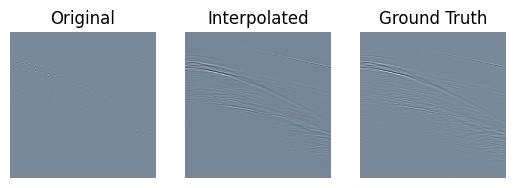

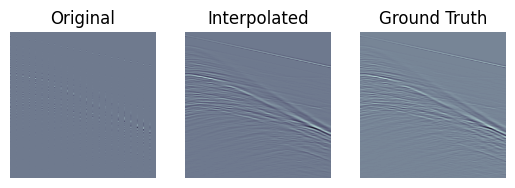

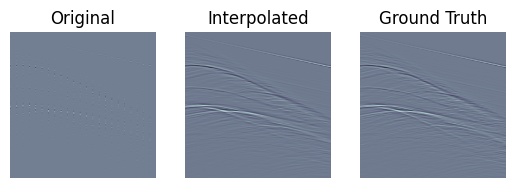

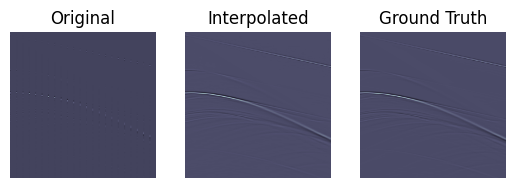

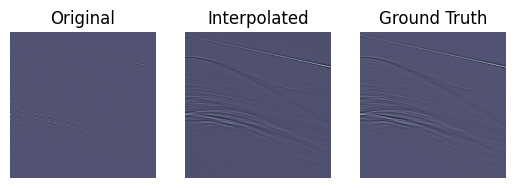

...

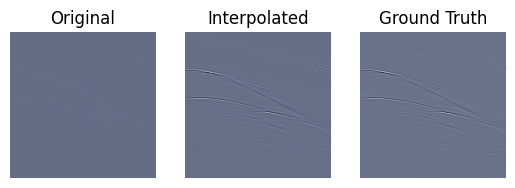

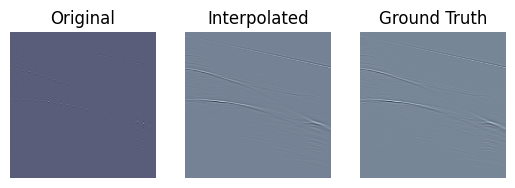

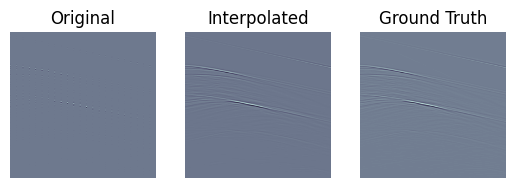

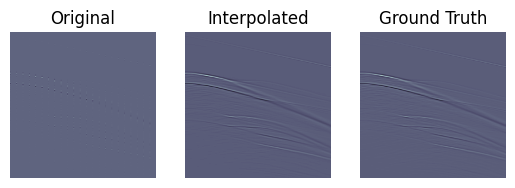

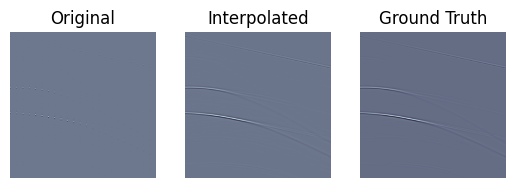

In [14]:

# Once the model is trained we can call it in saved_model and use it to make predictions
saved_model = load_model('Fill_Missing.hp5')

# x_test are unknown data that were not included in the training
predictions = saved_model.predict(x_test)

# Plot the results
for i, c in enumerate(predictions):
    plt.subplot(1,3,1)
    plt.imshow(x_test[i],cmap = 'bone')
    plt.axis('off')
    plt.title('Original')
    plt.subplot(1,3,2)
    plt.imshow(c, cmap='bone')
    plt.axis('off')
    plt.title('ML')
    plt.title('Interpolated')
    plt.subplot(1,3,3)
    plt.imshow(y_test[i], cmap = 'bone')
    plt.axis('off')
    plt.title('Ground Truth')

    plt.show()

